In [90]:
%matplotlib inline
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import math
import scipy
import seaborn as sns
import folium

# Introducción a Pandas

En pandas los datos estan segmentados en una estructura de Datos nueva y optimizada para carga de datos llamados DataFrames, que son basicamente tablas como las de una base de datos. Estas se dividen en tres componentes fundamentales:

    - Indices.
    - Columnas.
    - Datos.
    
Cada DataFrame esta dividido por columnas que puede ser representada como una serie de Pandas. Estas series son una estructura de 1 dimensión.
    
    - Indices.
    - Datos

In [5]:
tmp_data = [[1, 3, 4, 5]]
carros = pd.DataFrame(
            tmp_data, columns = [ 
                'BWM', 
                'FERRARI', 
                'MASERATI', 
                'CHEVROLET'
            ]
        )
print(carros)

   BWM  FERRARI  MASERATI  CHEVROLET
0    1        3         4          5


In [6]:
index = ['Ventas 2019', 'Ventas 2020']
columns = ['BMW', 'FERRARI', "MASERATTI", "CHEVROLET"]
tmp_data = [[1, 3, 4, 5], [3, 5, 34, 4]]
carros_ventas = pd.DataFrame(tmp_data, columns = columns, index = index)
carros_ventas

,BMW,FERRARI,MASERATTI,CHEVROLET
Ventas 2019,1,3,4,5
Ventas 2020,3,5,34,4


In [7]:
bmw_serie = pd.Series(carros_ventas['BMW'])
bmw_serie

Ventas 2019    1
Ventas 2020    3
Name: BMW, dtype: int64

In [8]:
index = ['Lapices', 'Cuadernos', 'Laptop']
datos = ['3 Lapices', '5 Cuadernos', '3 Macbook']

bolsa = pd.Series(datos, index = index, name = 'Bolsa')

bolsa

Lapices        3 Lapices
Cuadernos    5 Cuadernos
Laptop         3 Macbook
Name: Bolsa, dtype: object

# Pandas Basics

Pandas nos permite cargar información desde diferentes tipos de archivos, como lo pueden ser archivos CSV o TXT. Solo debemos especificar el caracter de separación que contiene este archivo, el por default es "," ya que es el estandar en archivos de tipo CSV.

In [10]:
housing = pd.read_csv('data/housing.csv', index_col = [0, 1], skiprows = 0)

print(housing.loc[(-122.23, 37.88)])
print(housing.loc[(-122.23, 37.88), 'total_rooms'])
print(housing.info())

                    housing_median_age  total_rooms  total_bedrooms  \
longitude latitude                                                    
-122.23   37.88                   41.0        880.0           129.0   

                    population  households  median_income  median_house_value  \
longitude latitude                                                              
-122.23   37.88          322.0       126.0         8.3252            452600.0   

                   ocean_proximity  
longitude latitude                  
-122.23   37.88           NEAR BAY  
longitude  latitude
-122.23    37.88       880.0
Name: total_rooms, dtype: float64
<class 'pandas.core.frame.DataFrame'>
MultiIndex: 20640 entries, (-122.23, 37.88) to (-121.24, 39.37)
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   housing_median_age  20640 non-null  float64
 1   total_rooms         20640 non-null  float64
 2   total_bedroom

/home/morfi/Developer/Personal/GH/pandas/venv/lib/python3.6/site-packages/ipykernel_launcher.py:3: PerformanceWarning: indexing past lexsort depth may impact performance.
  This is separate from the ipykernel package so we can avoid doing imports until
/home/morfi/Developer/Personal/GH/pandas/venv/lib/python3.6/site-packages/pandas/core/indexing.py:873: PerformanceWarning: indexing past lexsort depth may impact performance.
  return self._getitem_tuple(key)


<AxesSubplot:>

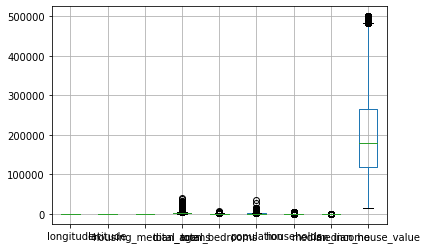

In [26]:
housing = pd.read_csv('data/housing.csv', index_col = None, skiprows = 0)
housing.boxplot()

<AxesSubplot:xlabel='housing_median_age', ylabel='total_rooms'>

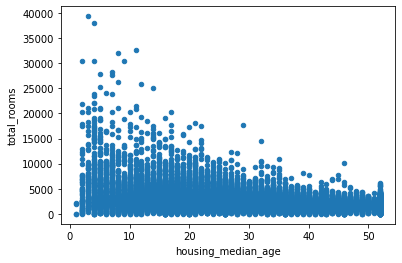

In [27]:
housing.plot.scatter(x = 'housing_median_age', y = 'total_rooms')

In [28]:
from pandas.plotting import scatter_matrix

array([[<AxesSubplot:xlabel='index', ylabel='index'>,
        <AxesSubplot:xlabel='longitude', ylabel='index'>,
        <AxesSubplot:xlabel='latitude', ylabel='index'>,
        <AxesSubplot:xlabel='housing_median_age', ylabel='index'>,
        <AxesSubplot:xlabel='total_rooms', ylabel='index'>,
        <AxesSubplot:xlabel='total_bedrooms', ylabel='index'>,
        <AxesSubplot:xlabel='population', ylabel='index'>,
        <AxesSubplot:xlabel='households', ylabel='index'>,
        <AxesSubplot:xlabel='median_income', ylabel='index'>,
        <AxesSubplot:xlabel='median_house_value', ylabel='index'>],
       [<AxesSubplot:xlabel='index', ylabel='longitude'>,
        <AxesSubplot:xlabel='longitude', ylabel='longitude'>,
        <AxesSubplot:xlabel='latitude', ylabel='longitude'>,
        <AxesSubplot:xlabel='housing_median_age', ylabel='longitude'>,
        <AxesSubplot:xlabel='total_rooms', ylabel='longitude'>,
        <AxesSubplot:xlabel='total_bedrooms', ylabel='longitude'>,
        <A

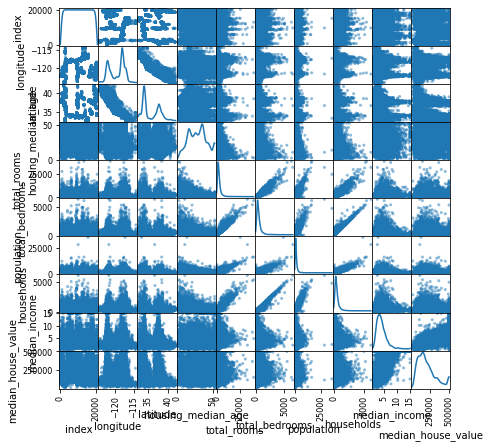

In [29]:
scatter_matrix(housing.reset_index(), diagonal = 'kde', figsize = (7, 7))

In [30]:
print(housing.total_rooms)

0         880.0
1        7099.0
2        1467.0
3        1274.0
4        1627.0
          ...  
20635    1665.0
20636     697.0
20637    2254.0
20638    1860.0
20639    2785.0
Name: total_rooms, Length: 20640, dtype: float64


Pandas nos permite acceder de diferentes formas a los datos que cargamos con anterioridad, esto haciendo uso de los metodos iloc y loc.

iloc nos permite acceder a los valores haciendo uso de indices para demarcar las posiciones que deseamos obtener:

In [32]:
sample = housing.iloc[[1,2,3,4,5,6,7]]
print(sample)

   longitude  latitude  housing_median_age  total_rooms  total_bedrooms  \
1    -122.22     37.86                21.0       7099.0          1106.0   
2    -122.24     37.85                52.0       1467.0           190.0   
3    -122.25     37.85                52.0       1274.0           235.0   
4    -122.25     37.85                52.0       1627.0           280.0   
5    -122.25     37.85                52.0        919.0           213.0   
6    -122.25     37.84                52.0       2535.0           489.0   
7    -122.25     37.84                52.0       3104.0           687.0   

   population  households  median_income  median_house_value ocean_proximity  
1      2401.0      1138.0         8.3014            358500.0        NEAR BAY  
2       496.0       177.0         7.2574            352100.0        NEAR BAY  
3       558.0       219.0         5.6431            341300.0        NEAR BAY  
4       565.0       259.0         3.8462            342200.0        NEAR BAY  
5   

loc nos permite acceder a los valores deseados haciendo uso del nombre propio de la columna y el indice:

In [33]:
housing.loc[(housing.total_bedrooms > 100) & (housing.total_bedrooms < 1500)]
housing.loc[housing['median_income'] > 3, 'median_income']

0        8.3252
1        8.3014
2        7.2574
3        5.6431
4        3.8462
          ...  
20625    4.1250
20630    3.5673
20631    3.5179
20632    3.1250
20634    3.7125
Name: median_income, Length: 13237, dtype: float64

# Funciones en pandas

Pandas posee una gran variedad de funciones en su core, las cuales nos permiten calcular diferentes valores esenciales a la hora de realizar un analisis de datos.

In [34]:
housing.median(axis = 0)

longitude               -118.4900
latitude                  34.2600
housing_median_age        29.0000
total_rooms             2127.0000
total_bedrooms           435.0000
population              1166.0000
households               409.0000
median_income              3.5348
median_house_value    179700.0000
dtype: float64

In [35]:
housing['total_rooms'].median()

2127.0

In [36]:
housing['housing_median_age'].unique()

array([41., 21., 52., 42., 50., 40., 49., 48., 51., 43.,  2., 46., 26.,
       20., 17., 36., 19., 23., 38., 35., 10., 16., 27., 39., 31., 29.,
       22., 37., 28., 34., 32., 47., 44., 30., 18., 45., 33., 24., 15.,
       14., 13., 25.,  5., 12.,  6.,  8.,  9.,  7.,  3.,  4., 11.,  1.])

In [37]:
housing['housing_median_age'].value_counts()

52.0    1273
36.0     862
35.0     824
16.0     771
17.0     698
34.0     689
26.0     619
33.0     615
18.0     570
25.0     566
32.0     565
37.0     537
15.0     512
19.0     502
27.0     488
24.0     478
30.0     476
28.0     471
20.0     465
29.0     461
31.0     458
23.0     448
21.0     446
14.0     412
22.0     399
38.0     394
39.0     369
42.0     368
44.0     356
43.0     353
40.0     304
13.0     302
41.0     296
45.0     294
10.0     264
11.0     254
46.0     245
5.0      244
12.0     238
8.0      206
9.0      205
47.0     198
4.0      191
48.0     177
7.0      175
6.0      160
50.0     136
49.0     134
3.0       62
2.0       58
51.0      48
1.0        4
Name: housing_median_age, dtype: int64

In [38]:
center_data = (housing.total_bedrooms - housing.total_bedrooms.mean()).to_numpy()

In [39]:
normal_data = housing.total_bedrooms.to_numpy()

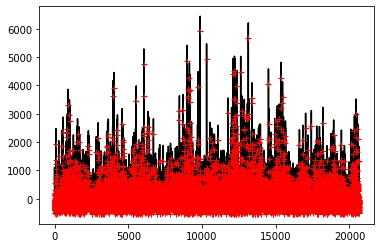

In [40]:
plt.plot(normal_data, 'k')
plt.plot(center_data, 'r+')
plt.show()

In [41]:
housing.loc[housing.total_bedrooms.idxmax()]

longitude               -121.79
latitude                  36.64
housing_median_age           11
total_rooms               32627
total_bedrooms             6445
population                28566
households                 6082
median_income            2.3087
median_house_value       118800
ocean_proximity       <1H OCEAN
Name: 9880, dtype: object

In [42]:
housing.median_income.map(lambda x: np.sqrt(x)).head()

0    2.885342
1    2.881215
2    2.693956
3    2.375521
4    1.961173
Name: median_income, dtype: float64

In [43]:
housing.median_income.head()

0    8.3252
1    8.3014
2    7.2574
3    5.6431
4    3.8462
Name: median_income, dtype: float64

In [44]:
tmp_housing_median_age_group = housing.groupby('housing_median_age')

In [45]:
tmp_housing_median_age_group.households.sum().head()

housing_median_age
1.0       397.0
2.0     42026.0
3.0     65716.0
4.0    191924.0
5.0    205983.0
Name: households, dtype: float64

In [46]:
tmp_housing_median_age_group.apply(lambda df: df.total_rooms.iloc[0])

housing_median_age
1.0        83.0
2.0       158.0
3.0     14014.0
4.0      3746.0
5.0     18634.0
6.0      2445.0
7.0     10648.0
8.0      3592.0
9.0      3666.0
10.0      875.0
11.0    12070.0
12.0    14316.0
13.0     2020.0
14.0     7355.0
15.0     5083.0
16.0      994.0
17.0     1237.0
18.0     1617.0
19.0     1207.0
20.0      835.0
21.0     7099.0
22.0     3682.0
23.0     1745.0
24.0     2459.0
25.0     1914.0
26.0      768.0
27.0     1055.0
28.0     5806.0
29.0      335.0
30.0     2211.0
31.0     4596.0
32.0     3809.0
33.0      142.0
34.0     5871.0
35.0      948.0
36.0     2914.0
37.0     3633.0
38.0      684.0
39.0     1715.0
40.0      751.0
41.0      880.0
42.0     2555.0
43.0     1007.0
44.0     3424.0
45.0     2964.0
46.0     2801.0
47.0     3175.0
48.0     1922.0
49.0     1130.0
50.0     1120.0
51.0     2665.0
52.0     1467.0
dtype: float64

In [52]:
tmp_housing_median_age_group.households.agg(['count', 'sum', 'min', 'max']).head()

,count,sum,min,max
housing_median_age,,,,
1.0,4,397.0,2.0,268.0
2.0,58,42026.0,9.0,3197.0
3.0,62,65716.0,104.0,5358.0
4.0,191,191924.0,2.0,5189.0
5.0,244,205983.0,20.0,4855.0


In [53]:
housing.sort_values(by = 'housing_median_age').head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
3130,-117.95,35.08,1.0,83.0,15.0,32.0,15.0,4.8750,141700.0,INLAND
19536,-120.93,37.65,1.0,2254.0,328.0,402.0,112.0,4.2500,189200.0,INLAND
12286,-116.95,33.86,1.0,6.0,2.0,8.0,2.0,1.6250,55000.0,INLAND
18972,-122.00,38.23,1.0,2062.0,343.0,872.0,268.0,5.2636,191300.0,INLAND
10391,-117.65,33.58,2.0,2411.0,354.0,703.0,217.0,7.8061,331400.0,<1H OCEAN


In [54]:
housing.sort_values(by = 'housing_median_age', ascending = False).head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
18881,-122.25,38.10,52.0,248.0,86.0,173.0,69.0,2.3000,109400.0,NEAR BAY
1671,-122.21,38.06,52.0,2735.0,559.0,1076.0,487.0,3.6154,155700.0,NEAR BAY
19116,-122.65,38.23,52.0,1735.0,347.0,712.0,343.0,3.1711,200800.0,<1H OCEAN
19516,-121.01,37.64,52.0,201.0,35.0,74.0,22.0,1.3036,75000.0,INLAND
16200,-121.27,37.95,52.0,1318.0,308.0,1368.0,310.0,1.8261,54600.0,INLAND


In [55]:
housing.sort_index().head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [56]:
housing.sort_values(by = ['housing_median_age', 'total_rooms']).head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
12286,-116.95,33.86,1.0,6.0,2.0,8.0,2.0,1.6250,55000.0,INLAND
3130,-117.95,35.08,1.0,83.0,15.0,32.0,15.0,4.8750,141700.0,INLAND
18972,-122.00,38.23,1.0,2062.0,343.0,872.0,268.0,5.2636,191300.0,INLAND
19536,-120.93,37.65,1.0,2254.0,328.0,402.0,112.0,4.2500,189200.0,INLAND
2774,-115.80,33.26,2.0,96.0,18.0,30.0,16.0,5.3374,47500.0,INLAND


In [57]:
housing.groupby('housing_median_age').size()

housing_median_age
1.0        4
2.0       58
3.0       62
4.0      191
5.0      244
6.0      160
7.0      175
8.0      206
9.0      205
10.0     264
11.0     254
12.0     238
13.0     302
14.0     412
15.0     512
16.0     771
17.0     698
18.0     570
19.0     502
20.0     465
21.0     446
22.0     399
23.0     448
24.0     478
25.0     566
26.0     619
27.0     488
28.0     471
29.0     461
30.0     476
31.0     458
32.0     565
33.0     615
34.0     689
35.0     824
36.0     862
37.0     537
38.0     394
39.0     369
40.0     304
41.0     296
42.0     368
43.0     353
44.0     356
45.0     294
46.0     245
47.0     198
48.0     177
49.0     134
50.0     136
51.0      48
52.0    1273
dtype: int64

In [58]:
housing.housing_median_age = housing.housing_median_age.astype('int32')

In [59]:
housing.housing_median_age

0        41
1        21
2        52
3        52
4        52
         ..
20635    25
20636    18
20637    17
20638    18
20639    16
Name: housing_median_age, Length: 20640, dtype: int32

In [60]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  int32  
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(8), int32(1), object(1)
memory usage: 1.5+ MB


In [61]:
housing.total_rooms.fillna(0)

0         880.0
1        7099.0
2        1467.0
3        1274.0
4        1627.0
          ...  
20635    1665.0
20636     697.0
20637    2254.0
20638    1860.0
20639    2785.0
Name: total_rooms, Length: 20640, dtype: float64

In [62]:
housing.total_rooms.replace('unknown', 'someValue')

0         880.0
1        7099.0
2        1467.0
3        1274.0
4        1627.0
          ...  
20635    1665.0
20636     697.0
20637    2254.0
20638    1860.0
20639    2785.0
Name: total_rooms, Length: 20640, dtype: float64

In [63]:
housing.rename(columns = {'housing_median_age': 'hma'})

,longitude,latitude,hma,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [64]:
housing.rename(index = {'longitude': 'long'})

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY
...,...,...,...,...,...,...,...,...,...,...
20635,-121.09,39.48,25,1665.0,374.0,845.0,330.0,1.5603,78100.0,INLAND
20636,-121.21,39.49,18,697.0,150.0,356.0,114.0,2.5568,77100.0,INLAND
20637,-121.22,39.43,17,2254.0,485.0,1007.0,433.0,1.7000,92300.0,INLAND
20638,-121.32,39.43,18,1860.0,409.0,741.0,349.0,1.8672,84700.0,INLAND


In [65]:
housing.join(housing, lsuffix = '_left', rsuffix = '_rigth').head()

,longitude_left,latitude_left,housing_median_age_left,total_rooms_left,total_bedrooms_left,population_left,households_left,median_income_left,median_house_value_left,ocean_proximity_left,longitude_rigth,latitude_rigth,housing_median_age_rigth,total_rooms_rigth,total_bedrooms_rigth,population_rigth,households_rigth,median_income_rigth,median_house_value_rigth,ocean_proximity_rigth
0,-122.23,37.88,41,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY,-122.23,37.88,41,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY,-122.22,37.86,21,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY,-122.24,37.85,52,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY,-122.25,37.85,52,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY,-122.25,37.85,52,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


# Conexión a Base de Datos.

Un gran poder en Pandas es la capacidad de poder conectarnos a bases de datos. Esto se puede realizar con diferentes plugins de conexión en python y utilizando el metodo pd.read_sql() al que le debemos pasar el query que queremos ejecutar y la cadena de conexión.

In [67]:
import psycopg2

In [ ]:
sql_connection = psycopg2.connect(user = 'elia',
                                  password = 'elia_pandas_20201008',
                                  host = 'xxx.xxx.xxx.xxx',
                                  port = '5432'
                                  database = "elia")

sql_query = '''
    select *
    from housing
    limit 10
'''

df = pd.read_sql(sql_query, sql_conn)
df.head(5)

# Data ... Science 

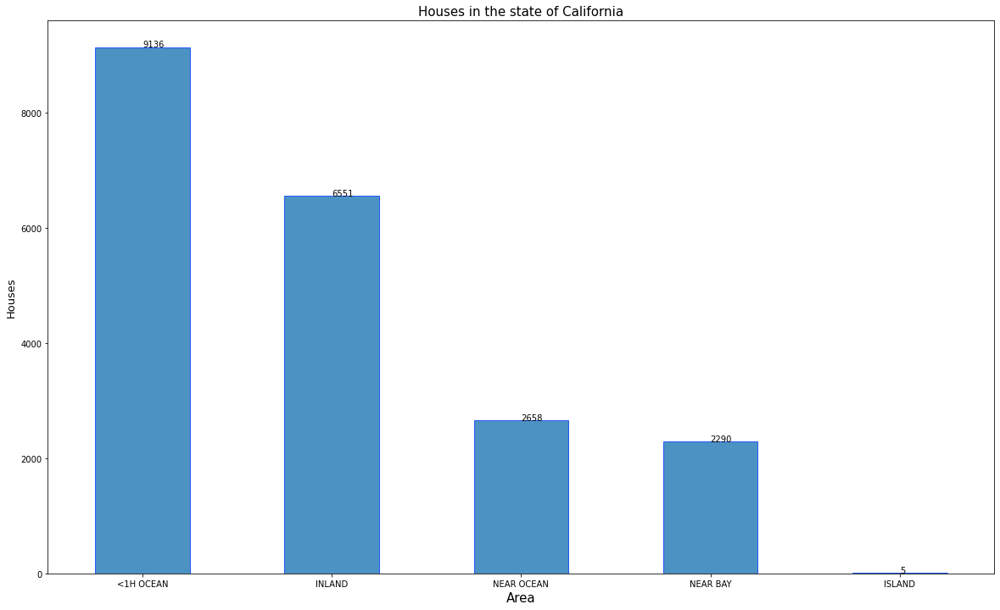

In [95]:
housing = pd.read_csv('data/housing.csv', index_col = None, skiprows = 0)

plt.figure(figsize = (20, 12))
housing['ocean_proximity'].value_counts().plot(
    kind = 'bar', 
    edgecolor = 'b', 
    alpha = 0.8
)

for index, value in enumerate(housing['ocean_proximity'].value_counts()):
    plt.text(index, value, str(value))
    
plt.xlabel('Area', fontsize = 15)
plt.ylabel('Houses', fontsize = 13)
plt.xticks(rotation = 0)
plt.title('Houses in the state of California', fontsize = 15)
plt.show()

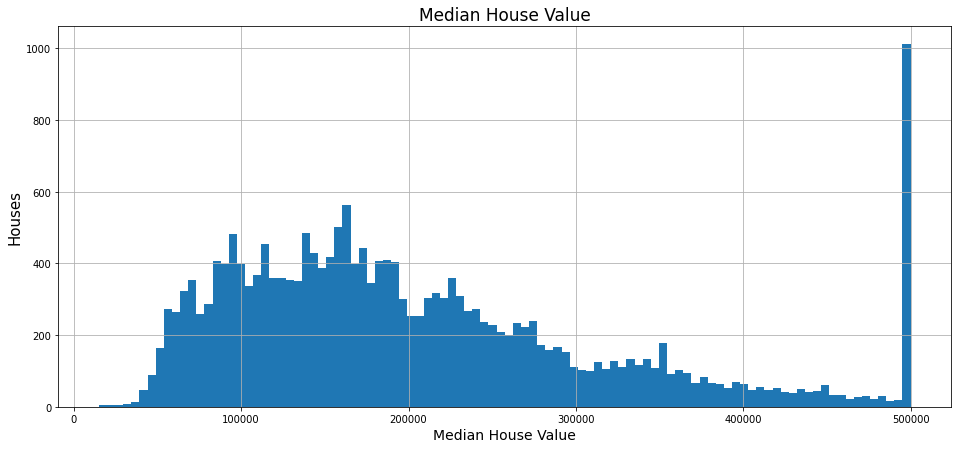

In [96]:
plt.figure(figsize = (16, 7))

housing['median_house_value'].hist(bins = 100)

plt.xlabel('Median House Value', fontsize = 14)
plt.ylabel('Houses', fontsize = 15)
plt.xticks(rotation = 0)
plt.title("Median House Value", fontsize = 17)
plt.show()

/home/morfi/Developer/Personal/GH/pandas/venv/lib/python3.6/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


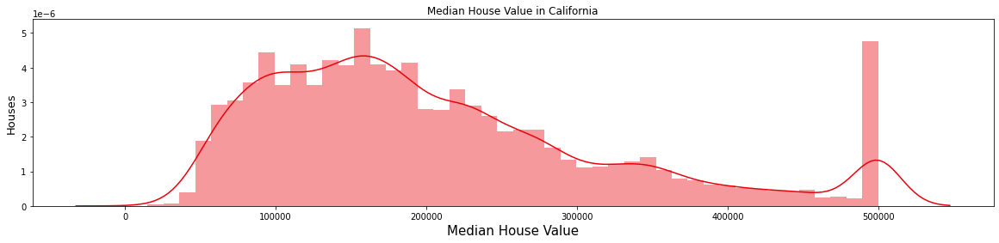

In [97]:
plt.figure(figsize = (20, 4))
sns.set_color_codes(palette = 'bright')
sns.distplot(housing['median_house_value'], color = 'r')
plt.title('Median House Value in California')
plt.xlabel('Median House Value', fontsize = 15)
plt.ylabel('Houses', fontsize = 13)
plt.show()

<Figure size 864x576 with 0 Axes>

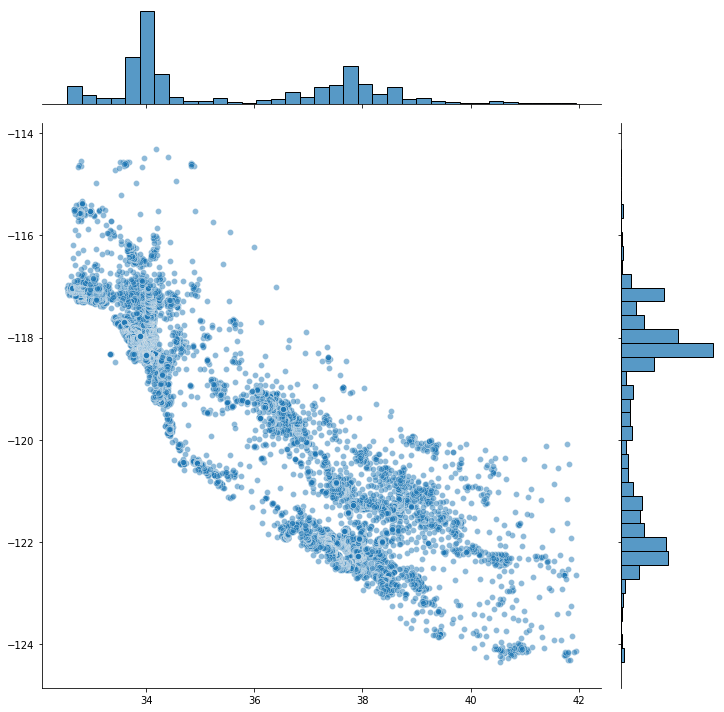

In [98]:
plt.figure(figsize=(12,8))
sns.jointplot(x=housing.latitude.values,y=housing.longitude.values,height=10, alpha=0.5)
plt.ylabel("longitude")
plt.xlabel("latitude")
plt.show()

In [105]:
maps = folium.Map(location = [37.166773, -120.436393], tiles = 'OpenStreetMap', zoom_start = 6)

for idx in range(0, len(housing)):
    folium.Circle(
        [housing.iloc[idx]['latitude'], housing.iloc[idx]['longitude']],
        popup = housing.iloc[idx]['ocean_proximity'], 
        radius = 10
    ).add_to(maps)

maps

In [109]:
maps_heat = folium.Map(location = [36.7783, -119.4179], zoom_start = 6, min_zoom = 5)

housing_maps = housing[['latitude', 'longitude']]

data = [[row['latitude'], row['longitude']] for idx, row in housing_maps.iterrows()]

from folium.plugins import HeatMap

HeatMap(data, radius = 10).add_to(maps_heat)

maps_heat